# Capstone Project 
Crystal Grant 

Data: Beekeeper - Frontline Success System 

Goal: Create Acurate Benchmarks and Best Practice metrics for Newly Onboarded Customers 

### Begin By Creating the required dataset - Combining Event details, User Accounts & Account Activation Metrics 

In [1]:
#Import Libraries 

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
#Import the datasets

all_tenants = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/tenant_overview_all.csv')
chats = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/chat sent 60 days 1+.csv')
forms_created = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/Form created 60 days .csv')
users_all = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/users_all.csv')
comments = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/comment created.csv')
documents = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/Doc art open 60 days 1+.csv')
form_submitted = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/Form Submitted.csv')
posts = pd.read_csv('/Users/crystal.grant/Desktop/Data Science/Capstone/Post Created.csv')  

In [3]:
all_tenants.head()

,Account_Status,Account,Subdomain,CSM,Phase,Current Licenses Sold,WAU_Trend WAU_28_days,WAU_7_day_avg,WAU_Licences,Created Users,Activated Users,Activation Rate,WAU %,MAU,WAU:Created,Weekly Chatting Users,chat_WAU_7_day_avg,% of Chatting WAU,Industry
0,Maintain,Santa Ana Star Casino Hotel,santaanastar,Shelby Snyder,2 - Success: Engage,800,-0.3,744,93.00%,765,762,99.60%,97.60%,104.30%,97.30%,364,743,49.00%,Hospitality
1,Maintain,Zaugg AG Rohrbach,zauggrohrbach,CS Operations,2 - Success: Engage,145,0.0,143,98.60%,150,147,98.00%,97.30%,98.60%,95.30%,10,142,7.00%,Manufacturing
2,Maintain,The Breakers. Palm Beach,thebreakers,Nittin Seehakoo,3 - Success: Operate,"2,362",-1.2,"2,218",93.90%,"2,349","2,343",99.70%,94.70%,99.60%,94.40%,988,2215,45.00%,Hospitality
3,Maintain,Casino Admiral Mendrisio,admiral,CS Operations,2 - Success: Engage,230,0.9,229,99.60%,243,241,99.20%,95.00%,98.80%,94.20%,65,227,29.00%,Hospitality
4,Maintain,GELO,gelo,CS Operations,2 - Success: Engage,180,0.0,171,95.00%,184,180,97.80%,95.00%,97.80%,92.90%,90,172,52.00%,Construction


In [4]:
users_all.shape

(1048575, 16)

In [5]:
users_all.head()

,$distinct_id,$name,$email,$distinct_id.1,$last_seen,$region,$campaigns,Admin Roles,Admin Role Types,$country_code,Subdomain,$ae_total_app_sessions,First Login,first_login,$ae_first_app_open_date,Role
0,d5e94fc9-5f07-4dfc-b676-ca4b39c8883d,undefined,undefined,d5e94fc9-5f07-4dfc-b676-ca4b39c8883d,2018-03-19T23:29:26,Bavaria,"[2293596,2619843]",undefined,No Admin,Switzerland,undefined,undefined,undefined,2016-11-16T05:26:32,undefined,undefined
1,09d89c12-8139-486b-82b0-a8231dd3042c,undefined,undefined,09d89c12-8139-486b-82b0-a8231dd3042c,2024-07-27T06:50:15,Aargau,"[2293596,2293760,2518120,2619843,3390471,50578...",undefined,No Admin,Switzerland,helvetic,1961,2017-01-03T10:24:09,2017-01-03T02:24:09,2022-10-26T08:04:46,member
2,831ab6c3-ad7e-488d-be4c-e383a82c705d,undefined,undefined,831ab6c3-ad7e-488d-be4c-e383a82c705d,2024-07-27T17:14:10,Alicante,"[2293591,2293663,2518092,3382712,5057848,50241...",undefined,No Admin,Spain,heathrow,2397,2016-11-22T17:07:26,2016-11-22T09:07:26,undefined,member
3,ae0edee1-db35-4f98-8eaa-a7fbbab20016,undefined,undefined,ae0edee1-db35-4f98-8eaa-a7fbbab20016,2022-08-03T16:53:37,Paris,"[2293591,2293663,2518092,3240339,4646136,50578...",undefined,No Admin,France,globus,7000,2017-04-12T19:29:05,2017-04-12T12:29:05,undefined,member
4,65c848ee-1504-496f-9dc6-ce28e04d449e,undefined,undefined,65c848ee-1504-496f-9dc6-ce28e04d449e,2024-07-26T17:14:50,Lower Saxony,"[2293596,2293760,2619843,3390488,4651875,50578...","[""stream_admin""]",Other Admin,Germany,leffers,6939,2017-02-13T13:45:42,2017-02-13T05:45:42,2018-10-04T02:07:25,member


In [6]:
#create a union of the users_all and all_tenants dataframes utilizing the Subdomain column

# New Data frame 
user_tenants = users_all.merge(all_tenants, on='Subdomain', how='left')

#Check the new dataframe
user_tenants.head()

,$distinct_id,$name,$email,$distinct_id.1,$last_seen,$region,$campaigns,Admin Roles,Admin Role Types,$country_code,...,Created Users,Activated Users,Activation Rate,WAU %,MAU,WAU:Created,Weekly Chatting Users,chat_WAU_7_day_avg,% of Chatting WAU,Industry
0,d5e94fc9-5f07-4dfc-b676-ca4b39c8883d,undefined,undefined,d5e94fc9-5f07-4dfc-b676-ca4b39c8883d,2018-03-19T23:29:26,Bavaria,"[2293596,2619843]",undefined,No Admin,Switzerland,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,09d89c12-8139-486b-82b0-a8231dd3042c,undefined,undefined,09d89c12-8139-486b-82b0-a8231dd3042c,2024-07-27T06:50:15,Aargau,"[2293596,2293760,2518120,2619843,3390471,50578...",undefined,No Admin,Switzerland,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,831ab6c3-ad7e-488d-be4c-e383a82c705d,undefined,undefined,831ab6c3-ad7e-488d-be4c-e383a82c705d,2024-07-27T17:14:10,Alicante,"[2293591,2293663,2518092,3382712,5057848,50241...",undefined,No Admin,Spain,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ae0edee1-db35-4f98-8eaa-a7fbbab20016,undefined,undefined,ae0edee1-db35-4f98-8eaa-a7fbbab20016,2022-08-03T16:53:37,Paris,"[2293591,2293663,2518092,3240339,4646136,50578...",undefined,No Admin,France,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,65c848ee-1504-496f-9dc6-ce28e04d449e,undefined,undefined,65c848ee-1504-496f-9dc6-ce28e04d449e,2024-07-26T17:14:50,Lower Saxony,"[2293596,2293760,2619843,3390488,4651875,50578...","[""stream_admin""]",Other Admin,Germany,...,702,676,96.30%,89.90%,95.60%,86.60%,187.0,607.0,31.00%,Retail


In [7]:
user_tenants.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 34 columns):
 #   Column                   Non-Null Count    Dtype  
---  ------                   --------------    -----  
 0   $distinct_id             1048575 non-null  object 
 1   $name                    1048575 non-null  object 
 2   $email                   1048575 non-null  object 
 3   $distinct_id.1           1048575 non-null  object 
 4   $last_seen               1048575 non-null  object 
 5   $region                  1015654 non-null  object 
 6   $campaigns               1048575 non-null  object 
 7   Admin Roles              1048575 non-null  object 
 8   Admin Role Types         1048575 non-null  object 
 9   $country_code            1047442 non-null  object 
 10  Subdomain                1047592 non-null  object 
 11  $ae_total_app_sessions   1048575 non-null  object 
 12  First Login              1048575 non-null  object 
 13  first_login              1048575 non-null 

In [8]:
#Drop the columns that are not needed for the analysis

user_tenants.drop(['$name', '$email', '$distinct_id.1', 'Admin Role Types', 'Account', '$region', 'First Login','$ae_first_app_open_date', 'Role', '$campaigns', 'Current Licenses Sold', 'WAU_Licences', 'Created Users', 'Activated Users', 'WAU:Created'], axis=1, inplace=True)

In [9]:

user_tenants.head()

,$distinct_id,$last_seen,Admin Roles,$country_code,Subdomain,$ae_total_app_sessions,first_login,Account_Status,CSM,Phase,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation Rate,WAU %,MAU,Weekly Chatting Users,chat_WAU_7_day_avg,% of Chatting WAU,Industry
0,d5e94fc9-5f07-4dfc-b676-ca4b39c8883d,2018-03-19T23:29:26,undefined,Switzerland,undefined,undefined,2016-11-16T05:26:32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,09d89c12-8139-486b-82b0-a8231dd3042c,2024-07-27T06:50:15,undefined,Switzerland,helvetic,1961,2017-01-03T02:24:09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,831ab6c3-ad7e-488d-be4c-e383a82c705d,2024-07-27T17:14:10,undefined,Spain,heathrow,2397,2016-11-22T09:07:26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ae0edee1-db35-4f98-8eaa-a7fbbab20016,2022-08-03T16:53:37,undefined,France,globus,7000,2017-04-12T12:29:05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,65c848ee-1504-496f-9dc6-ce28e04d449e,2024-07-26T17:14:50,"[""stream_admin""]",Germany,leffers,6939,2017-02-13T05:45:42,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.30%,89.90%,95.60%,187.0,607.0,31.00%,Retail


In [10]:
user_tenants.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 19 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   $distinct_id            1048575 non-null  object 
 1   $last_seen              1048575 non-null  object 
 2   Admin Roles             1048575 non-null  object 
 3   $country_code           1047442 non-null  object 
 4   Subdomain               1047592 non-null  object 
 5   $ae_total_app_sessions  1048575 non-null  object 
 6   first_login             1048575 non-null  object 
 7   Account_Status          707000 non-null   object 
 8   CSM                     707000 non-null   object 
 9   Phase                   707000 non-null   object 
 10  WAU_Trend WAU_28_days   707000 non-null   float64
 11  WAU_7_day_avg           707000 non-null   object 
 12  Activation Rate         707000 non-null   object 
 13  WAU %                   707000 non-null   object 
 14  MA

In [11]:
#Check for missing values
user_tenants.isnull().sum()

$distinct_id                   0
$last_seen                     0
Admin Roles                    0
$country_code               1133
Subdomain                    983
$ae_total_app_sessions         0
first_login                    0
Account_Status            341575
CSM                       341575
Phase                     341575
WAU_Trend WAU_28_days     341575
WAU_7_day_avg             341575
Activation Rate           341575
WAU %                     341575
MAU                       341575
Weekly Chatting Users     341575
chat_WAU_7_day_avg        341575
% of Chatting WAU         341575
Industry                  341575
dtype: int64

In [12]:
#Remove Rows with missing values
user_tenants = user_tenants.dropna()

user_tenants.isnull().sum()

$distinct_id              0
$last_seen                0
Admin Roles               0
$country_code             0
Subdomain                 0
$ae_total_app_sessions    0
first_login               0
Account_Status            0
CSM                       0
Phase                     0
WAU_Trend WAU_28_days     0
WAU_7_day_avg             0
Activation Rate           0
WAU %                     0
MAU                       0
Weekly Chatting Users     0
chat_WAU_7_day_avg        0
% of Chatting WAU         0
Industry                  0
dtype: int64

### The Main Data Frame is created (User Info + Account info)-- Now I will add the Event Details to understand usage

In [13]:
#Adding the Chats 60 Column to the user_tenants dataframe

#Check the chats dataframe
chats.head()

,$distinct_id,$name,$email,$distinct_id.1,$last_seen,$region,$campaigns,Admin Roles,Admin Role Types,$country_code,Subdomain,$ae_total_app_sessions,First Login,first_login,$ae_first_app_open_date,Role
0,dd2b93c4-1cde-4684-8318-634e54db4912,undefined,undefined,dd2b93c4-1cde-4684-8318-634e54db4912,2024-07-26T14:23:40,Skåne County,"[2293591,2293663,2518092,3157232,3382712,3386384]",undefined,No Admin,Sweden,avolta,931,2017-06-28T07:12:30,2017-06-28T00:12:30,undefined,member
1,08e75e18-94e1-4e8e-a348-3477b59a9a87,undefined,undefined,08e75e18-94e1-4e8e-a348-3477b59a9a87,2024-07-27T06:12:41,Buckinghamshire,"[2293591,2293663,2518092,3382712,5057848,50241...",undefined,No Admin,United Kingdom,heathrow,6241,2017-09-02T17:35:56,2017-09-02T10:35:56,undefined,member
2,20ac1c69-bdbb-4046-9de2-2b60178c32a9,undefined,undefined,20ac1c69-bdbb-4046-9de2-2b60178c32a9,2024-07-27T20:51:52,NaN,"[2293591,2293663,2518092,3382712,5024108,57038...",undefined,No Admin,United Kingdom,heathrow,3324,2017-10-12T11:32:30,2017-10-12T04:32:30,undefined,member
3,2501c508-6c32-4988-be5c-931a4ed820a2,undefined,undefined,2501c508-6c32-4988-be5c-931a4ed820a2,2024-07-24T21:45:35,Michigan,"[2293591,2518092,4646136,5057848,5132961,57038...",[],Other Admin,United States,byrne,2738,2017-10-30T18:09:48,2017-10-30T11:09:48,undefined,member
4,09d5eadf-8005-4f18-b1e7-7e75cf75dfd2,undefined,undefined,09d5eadf-8005-4f18-b1e7-7e75cf75dfd2,2024-07-27T17:21:31,Free and Hanseatic City of Hamburg,"[2293760,2619843,3390471,4651875,5057867,51977...","[""stream_admin""]",Other Admin,Germany,leffers,1687,2017-02-15T09:15:11,2017-02-15T01:15:11,2020-04-18T02:53:58,member


In [14]:
# Adding the Chat_60 column
user_tenants['Chats'] = user_tenants['$distinct_id'].isin(chats['$distinct_id']).astype(int)

user_tenants

,$distinct_id,$last_seen,Admin Roles,$country_code,Subdomain,$ae_total_app_sessions,first_login,Account_Status,CSM,Phase,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation Rate,WAU %,MAU,Weekly Chatting Users,chat_WAU_7_day_avg,% of Chatting WAU,Industry,Chats
4,65c848ee-1504-496f-9dc6-ce28e04d449e,2024-07-26T17:14:50,"[""stream_admin""]",Germany,leffers,6939,2017-02-13T05:45:42,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.30%,89.90%,95.60%,187.0,607.0,31.00%,Retail,1
5,1f09d0a6-948c-440d-8187-2804e65807e8,2024-07-27T15:26:00,undefined,United States,hilton,4458,2017-03-08T16:02:30,Defend,Payal Kumar,2 - Success: Engage,-0.6,692,69.60%,34.00%,39.40%,6.0,687.0,1.00%,Hospitality,0
9,4e719025-a4b3-42a7-ae58-0e67d85566da,2024-07-26T17:38:39,undefined,Switzerland,swisscasinos,2946,2016-12-01T09:37:19,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.60%,89.60%,97.40%,191.0,514.0,37.00%,Hospitality,1
17,386ae683-d2c0-4e34-9324-4fb21b38ef09,2024-07-24T11:35:14,undefined,Switzerland,swisscasinos,1669,2017-08-07T09:36:32,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.60%,89.60%,97.40%,191.0,514.0,37.00%,Hospitality,1
21,5d07e57c-2a16-45c3-a3f3-bb898366737c,2024-07-27T17:22:31,undefined,Germany,leffers,4289,2017-02-13T05:45:07,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.30%,89.90%,95.60%,187.0,607.0,31.00%,Retail,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048555,8ed8b240-6905-4e36-b0ad-e2783710875f,2023-04-12T07:11:32,undefined,Switzerland,burkhalter,64,2018-09-29T07:38:19,Grow,Flurin Nigg,2 - Success: Engage,-5.3,"2,327",75.70%,73.90%,84.90%,372.0,2294.0,16.00%,Construction,0
1048563,59186f85-dee5-4536-ae66-9aabf1f4cd34,2020-07-24T21:28:03,undefined,United States,lifetime,1,2018-10-02T11:31:56,Grow,Charlotte Buffington,2 - Success: Engage,8.8,"27,107",90.90%,62.80%,73.80%,14425.0,27108.0,53.00%,Hospitality,0
1048566,77e0bca6-1786-4ec4-84d4-973a4826f423,2020-06-17T19:45:10,undefined,Saudi Arabia,chalhoubgroup,5,2018-10-04T02:04:37,Defend,Amina Pitarch,2 - Success: Engage,-50.9,"5,851",80.80%,46.60%,70.90%,14.0,5953.0,0.00%,Retail,0
1048570,3dfcc483-15e4-45e1-b50f-7077b67fa060,2024-02-12T16:43:02,[],Saudi Arabia,chalhoubgroup,690,2018-10-04T06:20:20,Defend,Amina Pitarch,2 - Success: Engage,-50.9,"5,851",80.80%,46.60%,70.90%,14.0,5953.0,0.00%,Retail,0


In [15]:
# Adding the comments column
user_tenants['Comments'] = user_tenants['$distinct_id'].isin(comments['$distinct_id']).astype(int)

# Adding the documents column
user_tenants['Documents'] = user_tenants['$distinct_id'].isin(documents['$distinct_id']).astype(int)

# Adding the form_submitted column
user_tenants['Form_Submitted'] = user_tenants['$distinct_id'].isin(form_submitted['$distinct_id']).astype(int)

# Adding the posts column
user_tenants['Posts'] = user_tenants['$distinct_id'].isin(posts['$distinct_id']).astype(int)

# Adding the forms_created column
user_tenants['Forms_Created'] = user_tenants['$distinct_id'].isin(forms_created['$distinct_id']).astype(int)

user_tenants.head()

,$distinct_id,$last_seen,Admin Roles,$country_code,Subdomain,$ae_total_app_sessions,first_login,Account_Status,CSM,Phase,...,Weekly Chatting Users,chat_WAU_7_day_avg,% of Chatting WAU,Industry,Chats,Comments,Documents,Form_Submitted,Posts,Forms_Created
4,65c848ee-1504-496f-9dc6-ce28e04d449e,2024-07-26T17:14:50,"[""stream_admin""]",Germany,leffers,6939,2017-02-13T05:45:42,Maintain,CS Operations,2 - Success: Engage,...,187.0,607.0,31.00%,Retail,1,1,0,0,0,0
5,1f09d0a6-948c-440d-8187-2804e65807e8,2024-07-27T15:26:00,undefined,United States,hilton,4458,2017-03-08T16:02:30,Defend,Payal Kumar,2 - Success: Engage,...,6.0,687.0,1.00%,Hospitality,0,0,0,0,1,0
9,4e719025-a4b3-42a7-ae58-0e67d85566da,2024-07-26T17:38:39,undefined,Switzerland,swisscasinos,2946,2016-12-01T09:37:19,Maintain,Flurin Nigg,3 - Success: Operate,...,191.0,514.0,37.00%,Hospitality,1,0,0,1,0,0
17,386ae683-d2c0-4e34-9324-4fb21b38ef09,2024-07-24T11:35:14,undefined,Switzerland,swisscasinos,1669,2017-08-07T09:36:32,Maintain,Flurin Nigg,3 - Success: Operate,...,191.0,514.0,37.00%,Hospitality,1,0,1,1,0,0
21,5d07e57c-2a16-45c3-a3f3-bb898366737c,2024-07-27T17:22:31,undefined,Germany,leffers,4289,2017-02-13T05:45:07,Maintain,CS Operations,2 - Success: Engage,...,187.0,607.0,31.00%,Retail,1,1,0,0,0,0


### Begin Cleaning Data & Data Preparation

In [16]:
user_tenants.dtypes

$distinct_id               object
$last_seen                 object
Admin Roles                object
$country_code              object
Subdomain                  object
$ae_total_app_sessions     object
first_login                object
Account_Status             object
CSM                        object
Phase                      object
WAU_Trend WAU_28_days     float64
WAU_7_day_avg              object
Activation Rate            object
WAU %                      object
MAU                        object
Weekly Chatting Users     float64
chat_WAU_7_day_avg        float64
% of Chatting WAU          object
Industry                   object
Chats                       int64
Comments                    int64
Documents                   int64
Form_Submitted              int64
Posts                       int64
Forms_Created               int64
dtype: object

In [17]:
#Rename the columns

user_tenants.rename(columns={'$ae_total_app_sessions': 'total_app_sessions','$distinct_id': 'distinct_id', 'Subdomain': 'subdomain', 'Admin Roles': 'admin_role', '$last_seen': 'last_seen', '$country_code': 'country', 'WAU %':'WAU','WAU_7_day_avg': 'WAU_7_day_avg', 'Activation Rate': 'Activation_Rate', 'MAU': 'MAU', '% of Chatting WAU': 'Chatting_WAU', 'months_active': 'Months_Active', 'avg_monthly_sessions': 'Avg_Monthly_Sessions'}, inplace=True)

In [18]:
user_tenants['admin_role'].apply(pd.Series).stack().value_counts()

[]                                                                            391924
undefined                                                                     280155
["stream_admin"]                                                               13803
["stream_admin","group_admin"]                                                  3207
["admin"]                                                                       3071
["admin","stream_admin","group_admin","stream_moderator","org_unit_admin"]      2526
["admin","stream_admin"]                                                        2203
["stream_admin","stream_moderator","org_unit_admin"]                            1491
["stream_moderator","org_unit_admin"]                                           1425
["group_admin"]                                                                 1255
["stream_admin","admin","group_admin","stream_moderator","org_unit_admin"]      1232
["admin","stream_admin","stream_moderator","org_unit_admin"]     

In [19]:
#Change all undefined values to 'Member' in the admin_role column
user_tenants['admin_role'] = user_tenants['admin_role'].apply(lambda x: 'Member' if x == 'undefined' else x)

#Change all [] values to 'Member' in the admin_role column
user_tenants['admin_role'] = user_tenants['admin_role'].apply(lambda x: 'Member' if x == '[]' else x)

#Remove the [] and " characters from the admin_role column
user_tenants['admin_role'] = user_tenants['admin_role'].str.replace('[', '').str.replace(']', '').str.replace('"', '')

#remove "stream_moderator" from the admin_role column
user_tenants['admin_role'] = user_tenants['admin_role'].str.replace('stream_moderator', '')


In [20]:
#Sample the data to check values of the admin_role column
user_tenants['admin_role'].sample(20)

879312    Member
196882    Member
500701    Member
741299    Member
468922    Member
812245    Member
652784    Member
623230    Member
733299    Member
256489    Member
974249    Member
322044    Member
577786    Member
136468    Member
511126    Member
656070    Member
223550    Member
761793    Member
453897    Member
182532    Member
Name: admin_role, dtype: object

In [21]:
#Check Unique values of admin_role
user_tenants['admin_role'].unique()

array(['stream_admin', 'Member', 'admin,stream_admin', 'admin',
       'admin,stream_admin,group_admin,,org_unit_admin',
       'stream_admin,,org_unit_admin',
       'stream_admin,group_admin,org_unit_admin',
       'stream_admin,group_admin', 'admin,stream_admin,group_admin,',
       ',org_unit_admin', 'group_admin', 'org_unit_admin',
       'stream_admin,admin,group_admin,,org_unit_admin',
       'admin,stream_admin,,org_unit_admin',
       'stream_admin,org_unit_admin', 'admin,stream_admin,group_admin',
       'stream_admin,group_admin,,org_unit_admin', 'stream_admin,', '',
       'admin,,org_unit_admin', 'stream_admin,group_admin,',
       'admin,stream_admin,', 'group_admin,,org_unit_admin',
       'group_admin,org_unit_admin', 'admin,group_admin', 'group_admin,',
       'admin,group_admin,,org_unit_admin'], dtype=object)

In [22]:
# Reduce admin role to the highest level of access
# Define hierarchy
role_hierarchy = {
    'org_unit_admin': 0,
    'admin': 1,
    'group_admin': 2,
    'stream_admin': 3,
    'Member': 4
}

def get_highest_role(roles):
    # Split the roles and remove empty strings
    roles = [role.strip() for role in roles.split(',') if role.strip()]
    if not roles:
        return ''
    
    # Find the role with the lowest index in the hierarchy
    highest_role = min(roles, key=lambda x: role_hierarchy.get(x, float('inf')))
    return highest_role

# Apply the function to the DataFrame
user_tenants['admin_level'] = user_tenants['admin_role'].apply(get_highest_role)

In [23]:
#Check Unique values of admin_role
user_tenants['admin_level'].unique()

array(['stream_admin', 'Member', 'admin', 'org_unit_admin', 'group_admin',
       ''], dtype=object)

In [24]:
#Remove rows with null values
user_tenants = user_tenants.dropna()

In [25]:
#Convert Date columns to datetime format and remove Time -- Only leave YYYY-MM

user_tenants['last_seen'] = pd.to_datetime(user_tenants['last_seen'], errors='coerce').dt.to_period('M')

user_tenants['first_login'] = pd.to_datetime(user_tenants['first_login'], errors='coerce').dt.to_period('M')


In [26]:
#Use Last seen/First login to calculate the number of months since the user has been active - Create a new column called 'months_active'

user_tenants['months_active'] = (user_tenants['last_seen'].dt.year - user_tenants['first_login'].dt.year) * 12 + (user_tenants['last_seen'].dt.month - user_tenants['first_login'].dt.month)

In [27]:
#Count the Number of 'undefined' values in the total_app_sessions column
user_tenants['total_app_sessions'].value_counts()

total_app_sessions
undefined    227065
1              9446
2              9290
3              8800
4              8098
              ...  
18626             1
10559             1
10805             1
6485              1
29153             1
Name: count, Length: 8576, dtype: int64

In [28]:
#Remove the rows with 'undefined' values in the total_app_sessions column
user_tenants = user_tenants[user_tenants['total_app_sessions'] != 'undefined']

In [29]:
#Change the data type of the total_app_sessions column to integer
user_tenants['total_app_sessions'] = user_tenants['total_app_sessions'].astype(int)

#Create new column called 'avg_monthly_sessions' to calculate the average number of sessions per month for each user
user_tenants['avg_monthly_sessions'] = user_tenants['total_app_sessions'] / user_tenants['months_active']

#Check the data types
user_tenants.dtypes

distinct_id                 object
last_seen                period[M]
admin_role                  object
country                     object
subdomain                   object
total_app_sessions           int64
first_login              period[M]
Account_Status              object
CSM                         object
Phase                       object
WAU_Trend WAU_28_days      float64
WAU_7_day_avg               object
Activation_Rate             object
WAU                         object
MAU                         object
Weekly Chatting Users      float64
chat_WAU_7_day_avg         float64
Chatting_WAU                object
Industry                    object
Chats                        int64
Comments                     int64
Documents                    int64
Form_Submitted               int64
Posts                        int64
Forms_Created                int64
admin_level                 object
months_active                int64
avg_monthly_sessions       float64
dtype: object

In [30]:
#Create a new DF as a copy of user_tenant then Drop more columns that are not needed for the analysis - last_seen, first_login, total_app_sessions, Current Licenses Sold, WAU_License, Created users, Activated Users, WAU:Created

users_account = user_tenants.copy()

users_account.drop(['last_seen', 'first_login', 'total_app_sessions', 'Weekly Chatting Users', 'chat_WAU_7_day_avg'], axis=1, inplace=True)

In [31]:
#Convert WAU_7_day_avg, Activation Rate, wau, MAU, % of Chatting WAU to Floats/INT

users_account['WAU_7_day_avg'] = users_account['WAU_7_day_avg'].astype(str).str.replace(',', '').astype(int)

users_account['Activation_Rate'] = users_account['Activation_Rate'].astype(str).str.replace('%', '').astype(float)

users_account['WAU'] = users_account['WAU'].astype(str).str.replace('%', '').astype(float)

users_account['MAU'] = users_account['MAU'].astype(str).str.replace('%', '').astype(float)

users_account['Chatting_WAU'] = users_account['Chatting_WAU'].str.replace('%', '').astype(float)

#Check the data types
users_account.dtypes

distinct_id               object
admin_role                object
country                   object
subdomain                 object
Account_Status            object
CSM                       object
Phase                     object
WAU_Trend WAU_28_days    float64
WAU_7_day_avg              int64
Activation_Rate          float64
WAU                      float64
MAU                      float64
Chatting_WAU             float64
Industry                  object
Chats                      int64
Comments                   int64
Documents                  int64
Form_Submitted             int64
Posts                      int64
Forms_Created              int64
admin_level               object
months_active              int64
avg_monthly_sessions     float64
dtype: object

In [32]:
users_account.shape

(479928, 23)

In [33]:
#List of numerical columns
numerical_cols = users_account.select_dtypes(include=['int64', 'float64']).columns

numerical_cols

Index(['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU',
       'MAU', 'Chatting_WAU', 'Chats', 'Comments', 'Documents',
       'Form_Submitted', 'Posts', 'Forms_Created', 'months_active',
       'avg_monthly_sessions'],
      dtype='object')

## Exploratory Data Analysis

In [34]:
pd.set_option('display.max_columns', 200)
plt.style.use('ggplot')

In [35]:
users_account.head()

,distinct_id,admin_role,country,subdomain,Account_Status,CSM,Phase,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation_Rate,WAU,MAU,Chatting_WAU,Industry,Chats,Comments,Documents,Form_Submitted,Posts,Forms_Created,admin_level,months_active,avg_monthly_sessions
4,65c848ee-1504-496f-9dc6-ce28e04d449e,stream_admin,Germany,leffers,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.3,89.9,95.6,31.0,Retail,1,1,0,0,0,0,stream_admin,89,77.966292
5,1f09d0a6-948c-440d-8187-2804e65807e8,Member,United States,hilton,Defend,Payal Kumar,2 - Success: Engage,-0.6,692,69.6,34.0,39.4,1.0,Hospitality,0,0,0,0,1,0,Member,88,50.659091
9,4e719025-a4b3-42a7-ae58-0e67d85566da,Member,Switzerland,swisscasinos,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.6,89.6,97.4,37.0,Hospitality,1,0,0,1,0,0,Member,91,32.373626
17,386ae683-d2c0-4e34-9324-4fb21b38ef09,Member,Switzerland,swisscasinos,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.6,89.6,97.4,37.0,Hospitality,1,0,1,1,0,0,Member,83,20.108434
21,5d07e57c-2a16-45c3-a3f3-bb898366737c,Member,Germany,leffers,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.3,89.9,95.6,31.0,Retail,1,1,0,0,0,0,Member,89,48.191011


In [36]:
users_account.head()

,distinct_id,admin_role,country,subdomain,Account_Status,CSM,Phase,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation_Rate,WAU,MAU,Chatting_WAU,Industry,Chats,Comments,Documents,Form_Submitted,Posts,Forms_Created,admin_level,months_active,avg_monthly_sessions
4,65c848ee-1504-496f-9dc6-ce28e04d449e,stream_admin,Germany,leffers,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.3,89.9,95.6,31.0,Retail,1,1,0,0,0,0,stream_admin,89,77.966292
5,1f09d0a6-948c-440d-8187-2804e65807e8,Member,United States,hilton,Defend,Payal Kumar,2 - Success: Engage,-0.6,692,69.6,34.0,39.4,1.0,Hospitality,0,0,0,0,1,0,Member,88,50.659091
9,4e719025-a4b3-42a7-ae58-0e67d85566da,Member,Switzerland,swisscasinos,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.6,89.6,97.4,37.0,Hospitality,1,0,0,1,0,0,Member,91,32.373626
17,386ae683-d2c0-4e34-9324-4fb21b38ef09,Member,Switzerland,swisscasinos,Maintain,Flurin Nigg,3 - Success: Operate,-0.6,516,96.6,89.6,97.4,37.0,Hospitality,1,0,1,1,0,0,Member,83,20.108434
21,5d07e57c-2a16-45c3-a3f3-bb898366737c,Member,Germany,leffers,Maintain,CS Operations,2 - Success: Engage,-0.2,608,96.3,89.9,95.6,31.0,Retail,1,1,0,0,0,0,Member,89,48.191011


<Axes: ylabel='Frequency'>

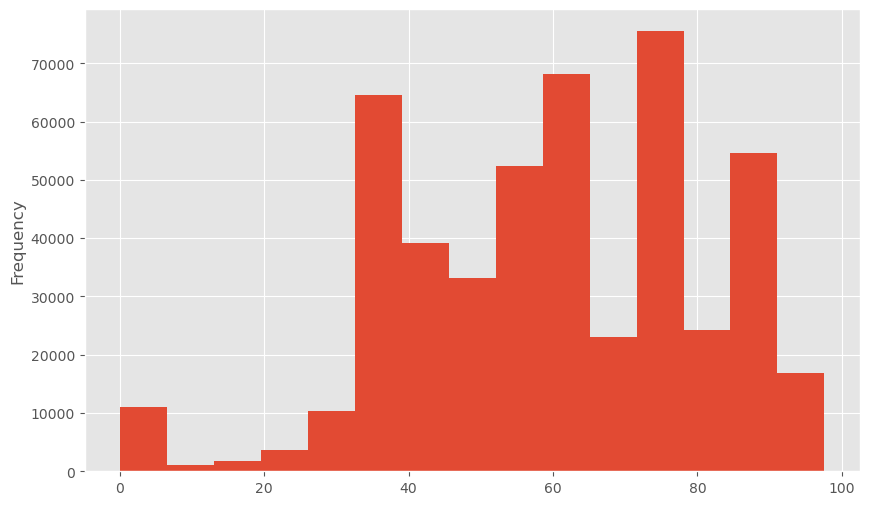

In [37]:
users_account['WAU'].plot(kind='hist', bins=15, figsize=(10, 6))

#### Correlation Heat Map draws connection between - Chatting WAU and Overall WAU + Positive correlation between Posting & Commenting 

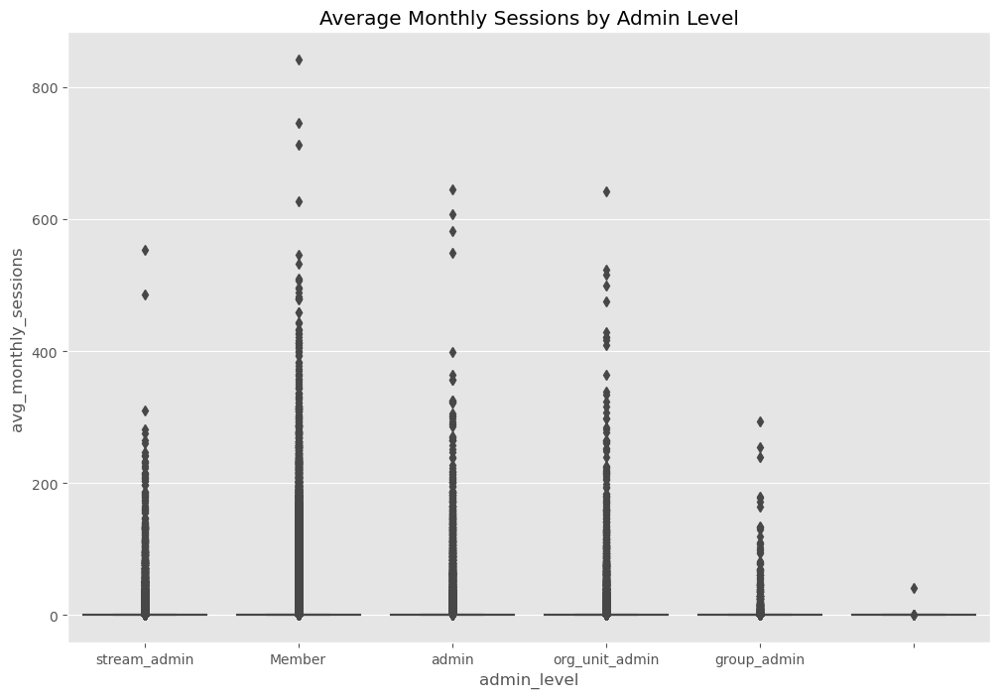

In [38]:
#Plot the average monthly sessions by each admin level 
plt.figure(figsize=(12, 8))
sns.boxplot(x='admin_level', y='avg_monthly_sessions', data=users_account)
plt.title('Average Monthly Sessions by Admin Level')
plt.show()

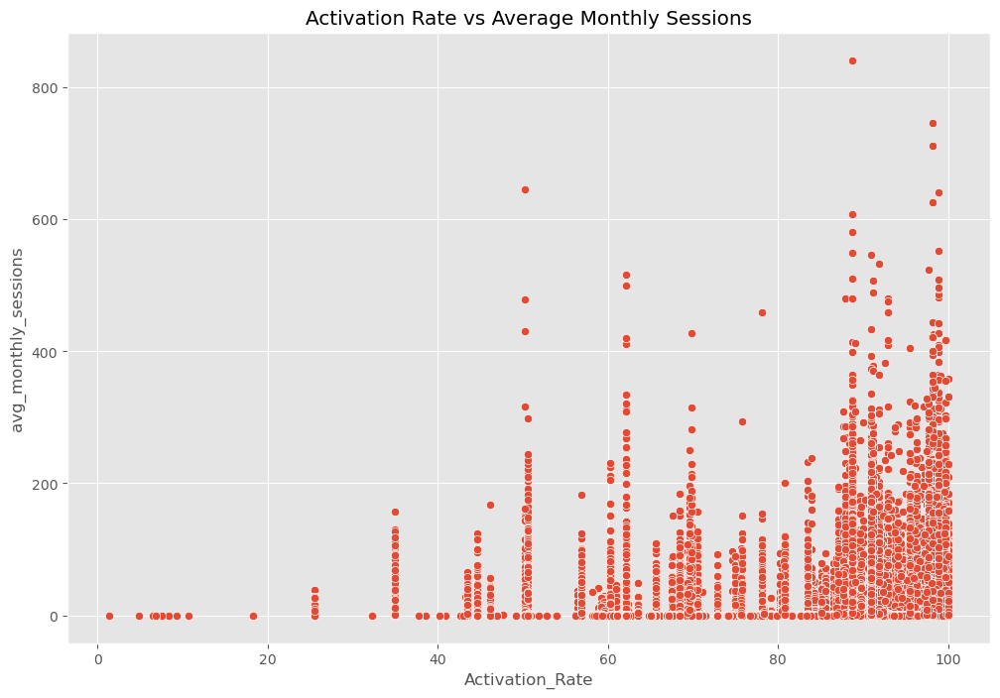

In [39]:
#Scatter Plot the average monthly sessions by each admin level 
plt.figure(figsize=(12, 8))
sns.scatterplot(y='avg_monthly_sessions', x='Activation_Rate', data=users_account)
plt.title('Activation Rate vs Average Monthly Sessions')
plt.show()


#### Accounts with lower activation will have less monthly session

/Users/crystal.grant/anaconda3/lib/python3.11/site-packages/numpy/lib/function_base.py:4573: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


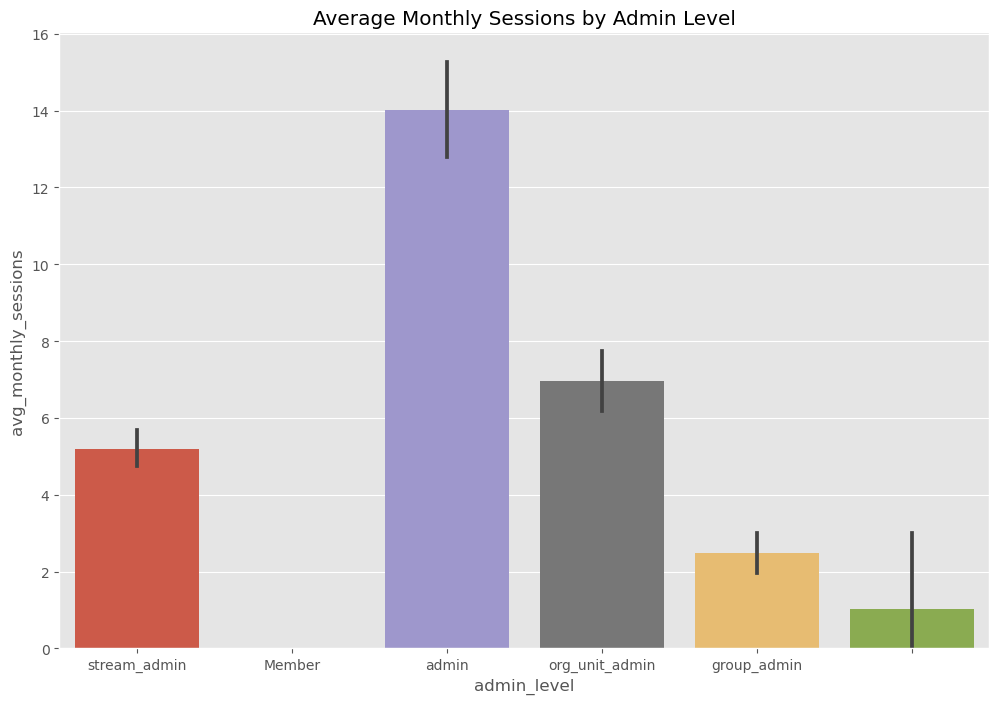

In [40]:
#bar plot the average monthly sessions by each admin level 
plt.figure(figsize=(12, 8))
sns.barplot(x='admin_level', y='avg_monthly_sessions', data=users_account)
plt.title('Average Monthly Sessions by Admin Level')
plt.show()

In [41]:
#locate the rows with admin_level not equal to 'Member', 'stream_admin', 'group_admin', 'admin', 'org_unit_admin'
users_account = users_account[users_account['admin_level'].isin(['Member', 'stream_admin', 'group_admin', 'admin', 'org_unit_admin'])]

#Check the unique values of the admin_level column
users_account['admin_level'].unique()

#Check the shape of the dataframe
users_account.shape

(479887, 23)

In [42]:
users_account.describe()

,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation_Rate,WAU,MAU,Chatting_WAU,Chats,Comments,Documents,Form_Submitted,Posts,Forms_Created,months_active,avg_monthly_sessions
count,479887.000000,479887.00000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,479887.000000,4.798870e+05
mean,-9.484063,10223.63557,80.067460,60.169552,72.669828,17.927225,0.123317,0.057970,0.066730,0.030420,0.035598,0.000406,21848.820164,inf
std,23.342719,11724.82834,16.517995,21.122065,19.996525,20.828869,0.328801,0.233687,0.249555,0.171739,0.185286,0.020154,7301.717942,NaN
min,-62.100000,0.00000,1.400000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.113872e-05
25%,-5.400000,663.00000,69.300000,42.400000,57.800000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24278.000000,9.463463e-04
50%,-0.400000,4701.00000,86.800000,62.800000,73.800000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24295.000000,4.566398e-03
75%,1.200000,23094.00000,93.500000,77.900000,89.300000,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24308.000000,2.295541e-02
max,23.100000,37942.00000,100.000000,97.600000,105.600000,200.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,24308.000000,inf


In [43]:
#unique values of avg_monthly_sessions
users_account['avg_monthly_sessions'].value_counts()

avg_monthly_sessions
0.000288    826
0.000123    818
0.000206    815
0.000165    814
0.000247    809
           ... 
0.032925      1
0.042473      1
0.034324      1
0.019258      1
1.163636      1
Name: count, Length: 84493, dtype: int64

In [44]:
# Replace infinite values with NaN
users_account.replace([np.inf, -np.inf], np.nan, inplace=True)

# Drop rows with NaN values
users_account.dropna(inplace=True)

In [45]:
users_account.shape

(479850, 23)

In [46]:
users_account.query('admin_level != "Non_Member"') \
    .groupby('admin_level')['avg_monthly_sessions'] \
    .agg(['mean', 'median', 'std', 'count']) \
    .sort_values('mean', ascending=False)


,mean,median,std,count
admin_level,,,,
admin,14.006603,0.035194,42.389200,4590
org_unit_admin,6.952024,0.017469,32.227284,6724
stream_admin,5.197106,0.007817,22.577685,8746
Member,2.492041,0.004361,14.226034,456884
group_admin,2.473495,0.005081,14.882451,2906


<Axes: xlabel='Chats', ylabel='avg_monthly_sessions'>

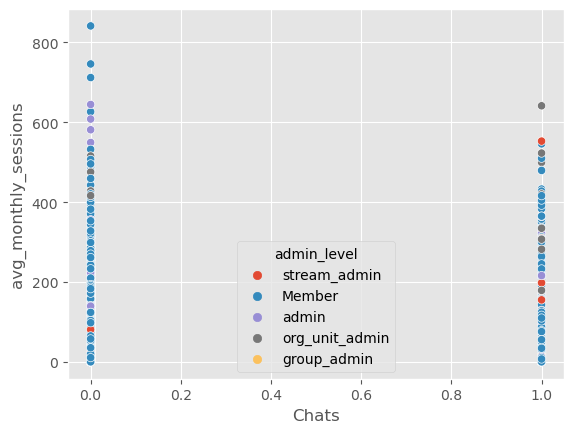

In [47]:
sns.scatterplot(y='avg_monthly_sessions', x='Chats', hue="admin_level", data=users_account)

<Axes: xlabel='Form_Submitted', ylabel='avg_monthly_sessions'>

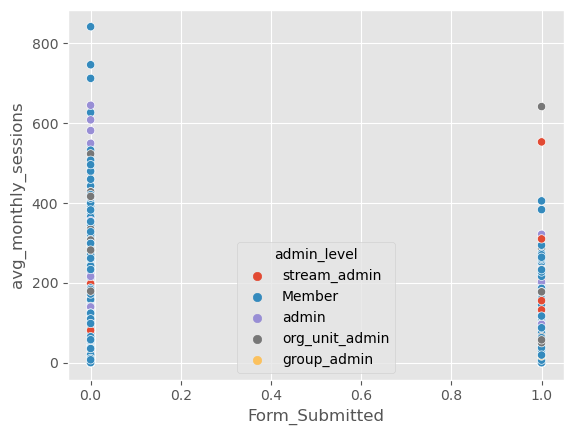

In [48]:
sns.scatterplot(y='avg_monthly_sessions', x='Form_Submitted', hue='admin_level', data=users_account)

In [49]:
#duplicate the Account Status column
users_account['Account_Status_All'] = users_account['Account_Status']

#Create Mapping for Account_Status_All Column

mapping = {'Account_Status_All': {'Maintain': 0, 'Grow': 1, 'Defend': 2, 'Churned': 3}}

#Replace the string with dummy variables
users_account.replace(mapping, inplace=True)

In [50]:
#duplicate the Admin_level column
users_account['admin_level_all'] = users_account['admin_level']


#Create Mapping for admin level_All Column

mapping = {'admin_level_all': {'Member': 0, 'stream_admin': 1, 'group_admin': 2, 'org_unit_admin': 3, 'admin': 4}}

#Replace the string with dummy variables
users_account.replace(mapping, inplace=True)

In [51]:
#Create Dummies for the admin_level column
users_account = pd.get_dummies(users_account, columns=['admin_level'])

# Convert the dummy columns to int
dummy_columns = users_account.columns[users_account.columns.str.startswith('admin_level')]
users_account[dummy_columns] = users_account[dummy_columns].astype(int)


#Create Dummies for the Account_Status column
users_account = pd.get_dummies(users_account, columns=['Account_Status'])

# Convert the dummy columns to int
dummies = users_account.columns[users_account.columns.str.startswith('Account_Status')]
users_account[dummies] = users_account[dummies].astype(int)


In [52]:
users_account.dtypes

distinct_id                    object
admin_role                     object
country                        object
subdomain                      object
CSM                            object
Phase                          object
WAU_Trend WAU_28_days         float64
WAU_7_day_avg                   int64
Activation_Rate               float64
WAU                           float64
MAU                           float64
Chatting_WAU                  float64
Industry                       object
Chats                           int64
Comments                        int64
Documents                       int64
Form_Submitted                  int64
Posts                           int64
Forms_Created                   int64
months_active                   int64
avg_monthly_sessions          float64
Account_Status_All              int64
admin_level_all                 int64
admin_level_Member              int64
admin_level_admin               int64
admin_level_group_admin         int64
admin_level_

#Create Mapping for string data to dummy variable/integers
admin_level_map = {
    'Member': 0,
    'stream_admin': 1,
    'group_admin': 2,
    'admin': 3,
    'org_unit_admin': 4
}

# Map the values to integers
users_account['admin_level'] = users_account['admin_level'].map(admin_level_map)

#Check the unique values of the admin_level column
users_account['admin_level'].unique()

In [53]:
# Remove non-numeric columns from the dataframe
numeric_col = users_account.select_dtypes(include=['int64', 'float64']).columns
users_accounts_numeric = users_account[numeric_col]

# Calculate the correlation
correlations = users_accounts_numeric.corr()

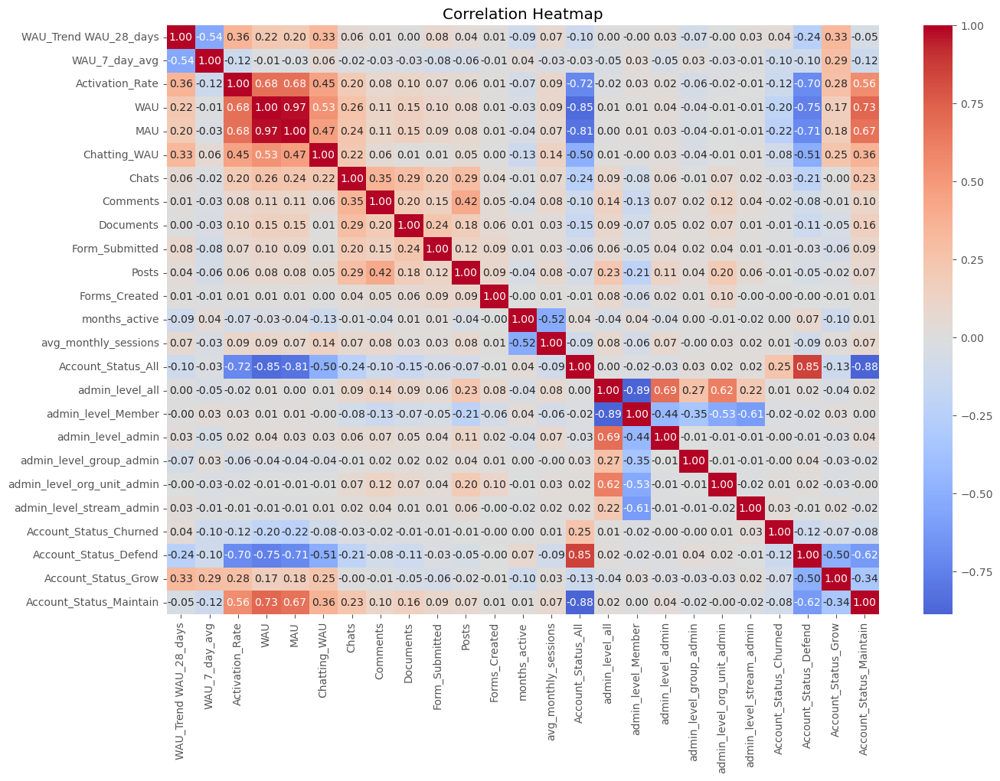

In [54]:
#Sns Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(correlations, annot=True, fmt='.2f', cmap='coolwarm', center=0)
plt.title('Correlation Heatmap')
plt.show()

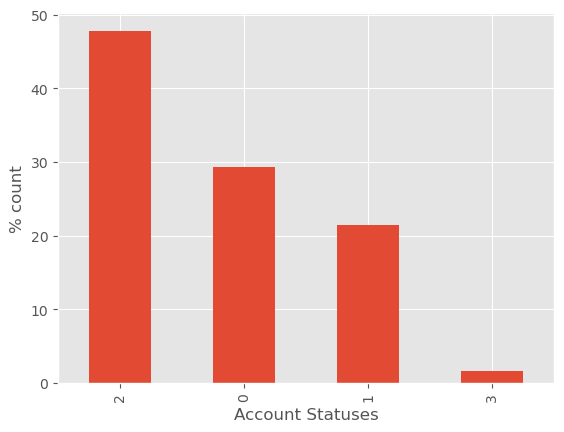

In [55]:
# Plot % of Account Status values
(users_account['Account_Status_All'].value_counts(normalize=True) * 100).plot(kind='bar')
plt.ylabel('% count')
plt.xlabel('Account Statuses')
plt.show()

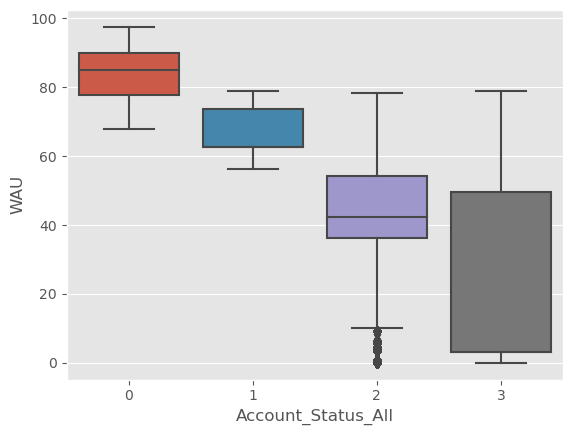

In [56]:
# Compare distribution of perimeter_mean between Status Groups groups

sns.boxplot(x='Account_Status_All', y='WAU', data=users_account)
plt.show()

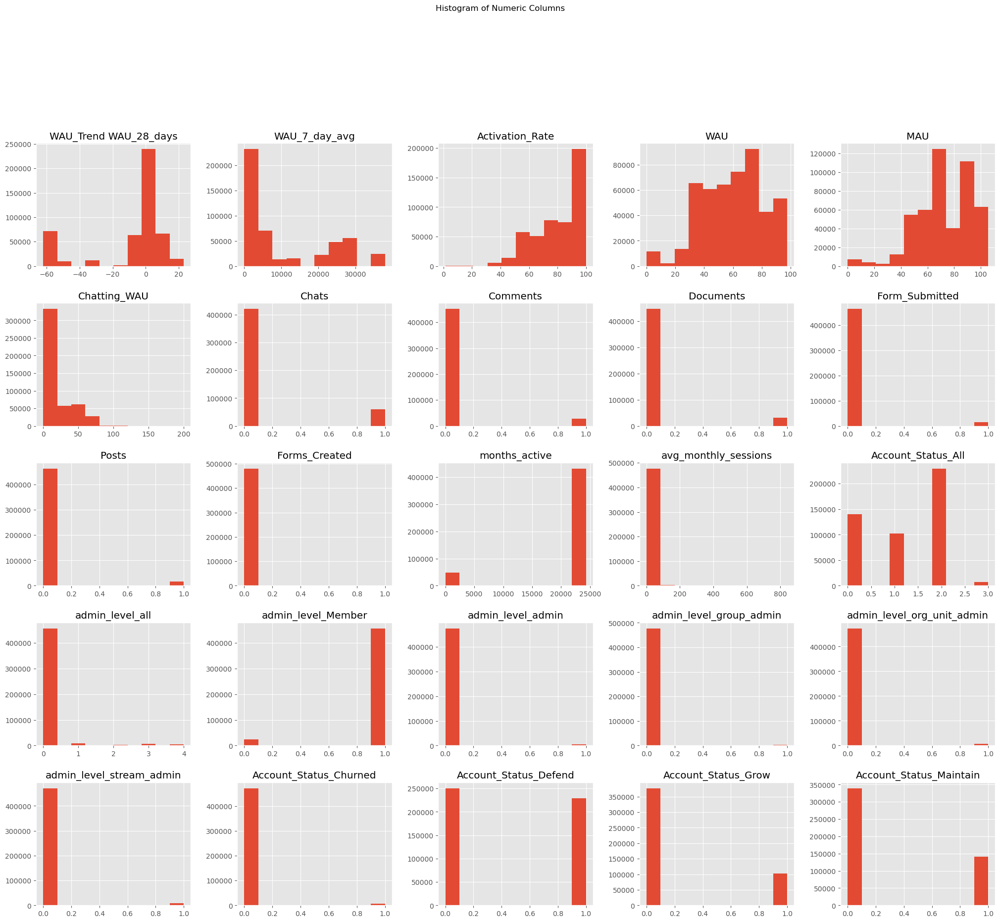

In [57]:
#Histogram of the numeric columns to understand distribution
users_accounts_numeric.hist(figsize=(25, 20), bins=10)
plt.suptitle('Histogram of Numeric Columns', x=0.5, y=1.02, ha='center', fontsize='large')
plt.show()

In [58]:
#Create a new dataframe with selected columns
plot_data = users_account[['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU','MAU', 'Chatting_WAU', 'months_active','avg_monthly_sessions']]

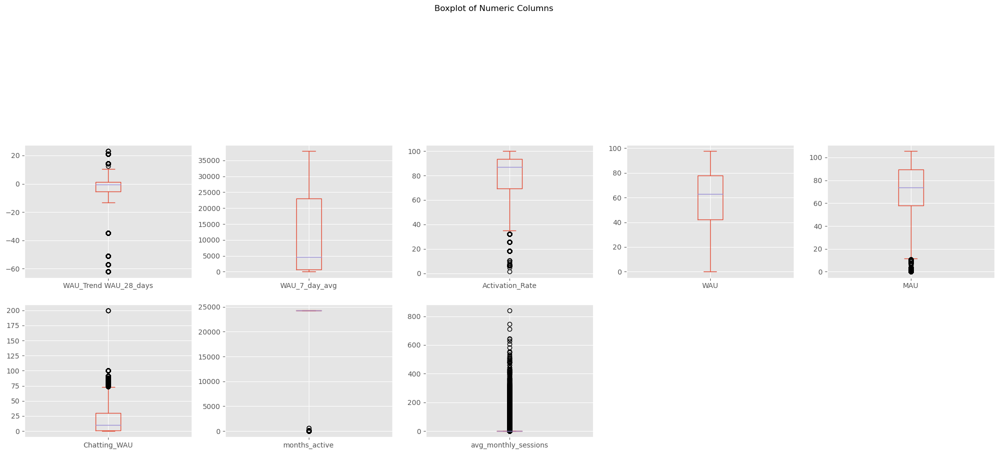

In [59]:
#Boxplot of the numeric columns to understand distribution
plot_data.plot(kind='box', subplots=True, layout=(5, 5), figsize=(25, 20))
plt.suptitle('Boxplot of Numeric Columns', x=0.5, y=1.02, ha='center', fontsize='large')
plt.show()

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


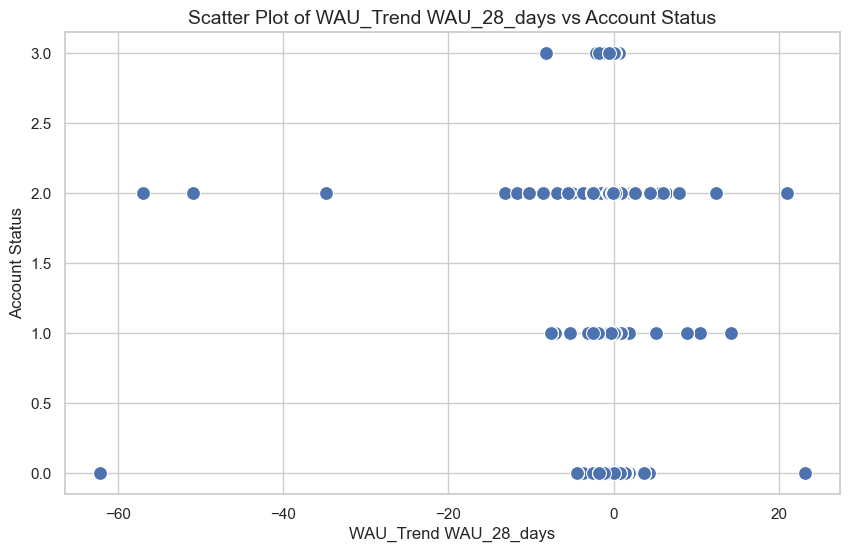

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


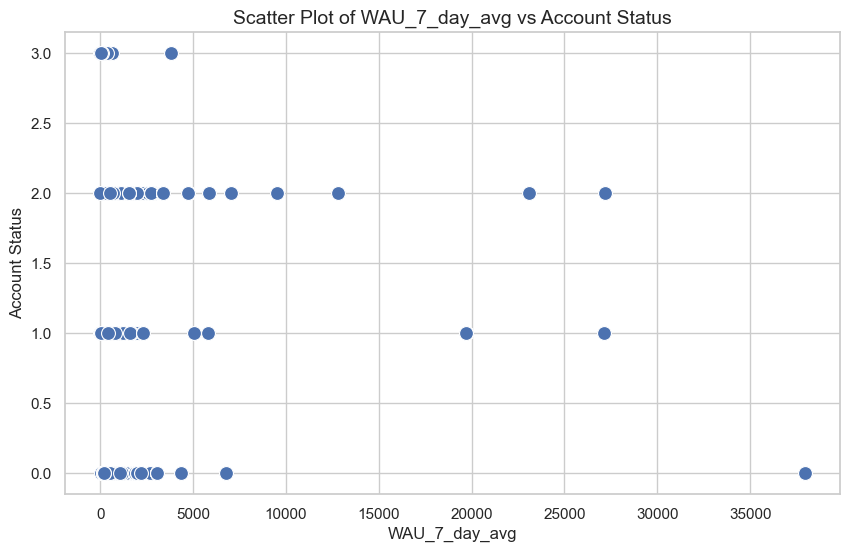

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


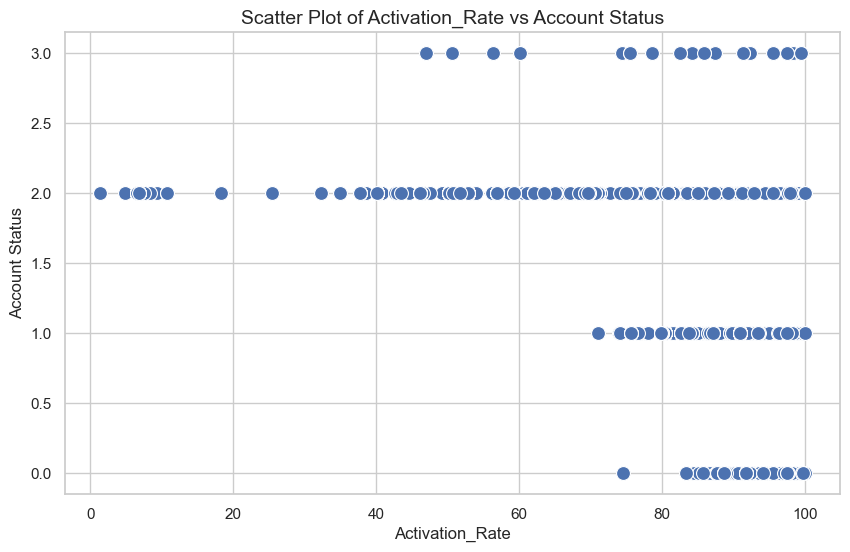

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


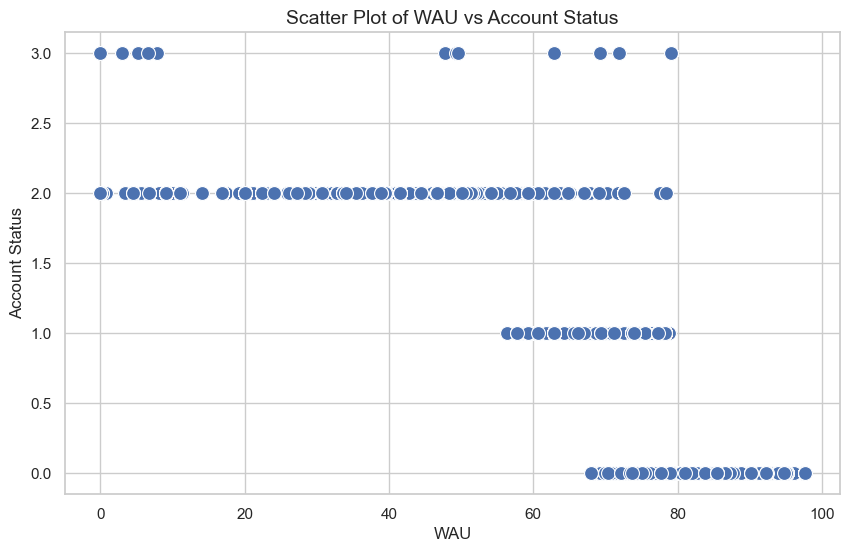

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


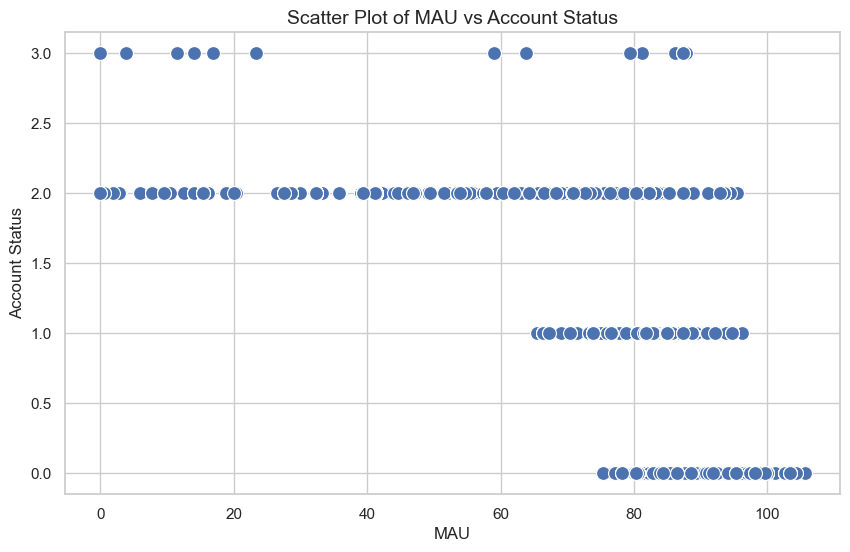

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


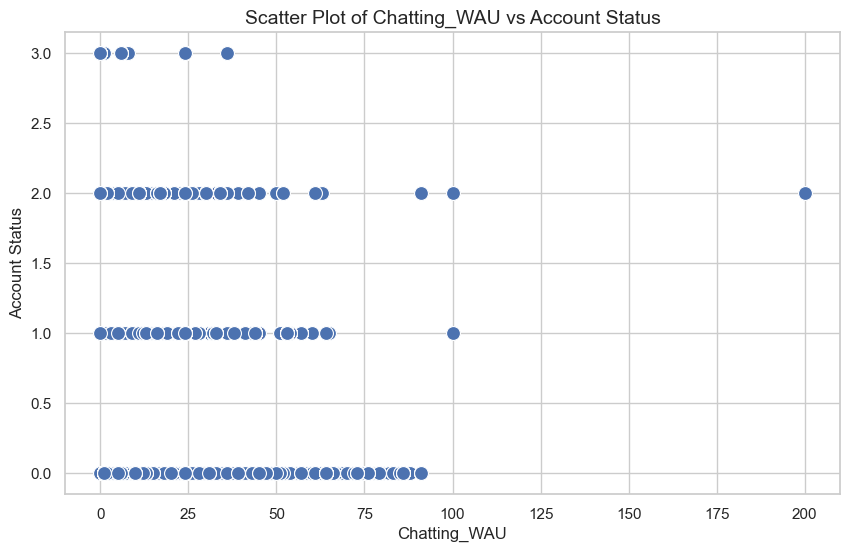

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


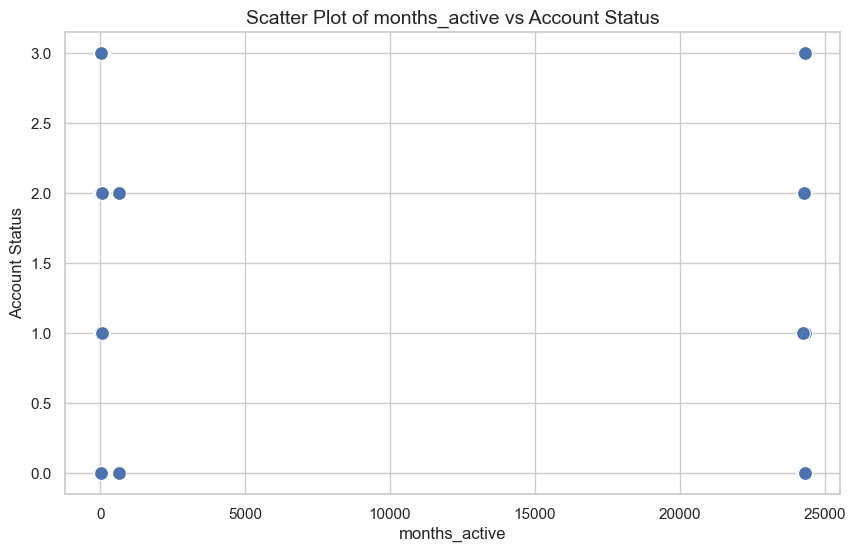

/var/folders/z5/4t69km9j0nx1j29kf6fxc_6h0000gp/T/ipykernel_37124/1819782842.py:10: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')


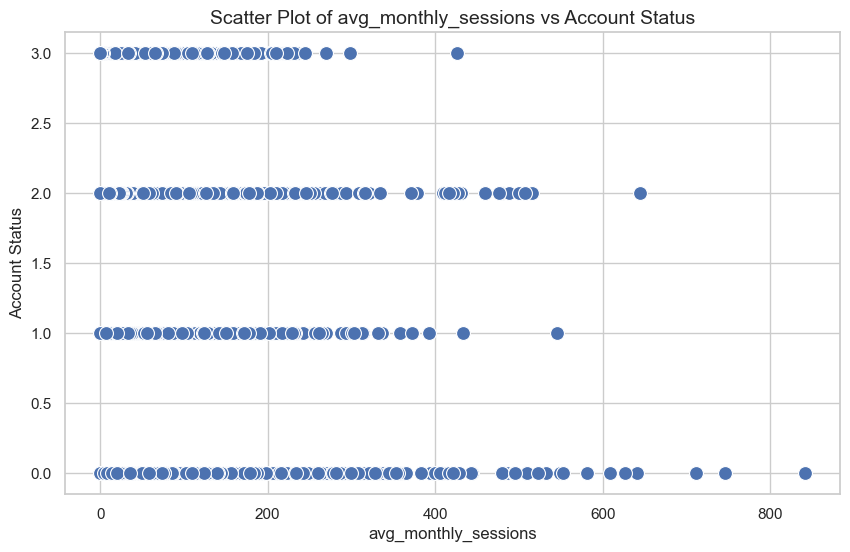

In [60]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set a seaborn theme
sns.set_theme(style="whitegrid")

# Loop through the variables and create scatter plots
for i in ['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU', 'MAU', 'Chatting_WAU', 'months_active', 'avg_monthly_sessions']:
    plt.figure(figsize=(10, 6))  # Adjust the plot size
    sns.scatterplot(x=i, y='Account_Status_All', data=users_account, s=100, marker='o', edgecolor='w', palette='viridis')
    
    plt.title(f'Scatter Plot of {i} vs Account Status', fontsize=14)  # Add a title
    plt.xlabel(i, fontsize=12)  # Customize x-axis label
    plt.ylabel('Account Status', fontsize=12)  # Customize y-axis label
    plt.grid(True)  # Add gridlines
    plt.show()

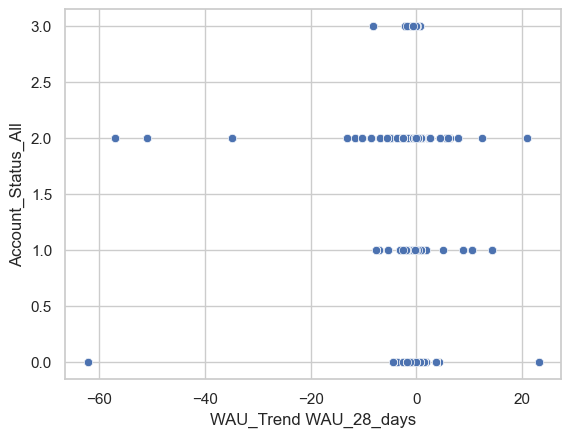

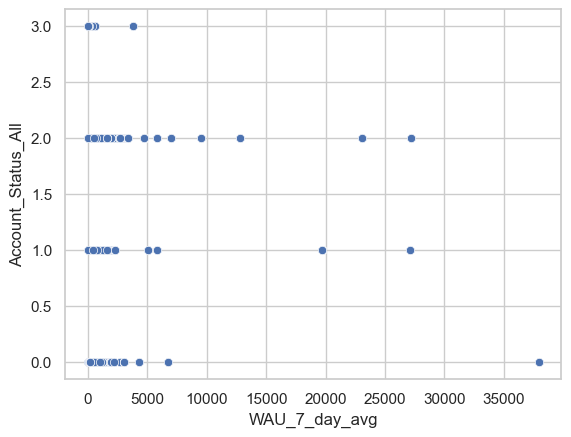

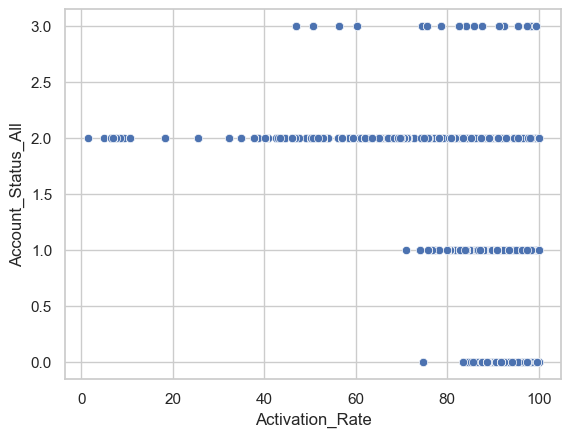

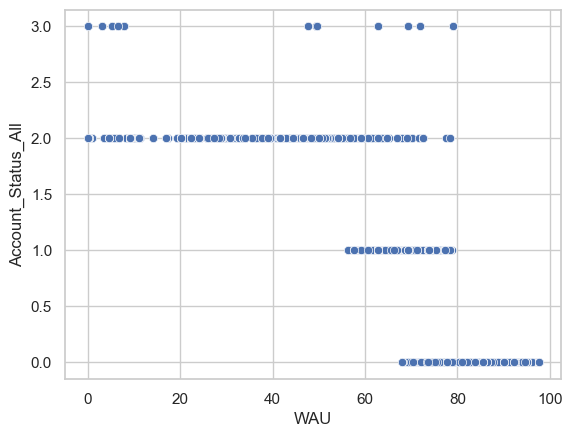

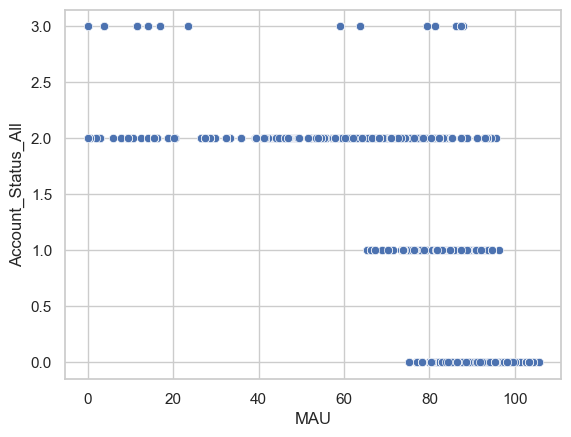

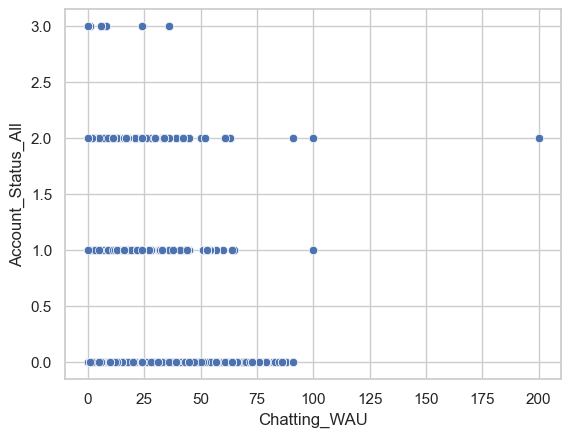

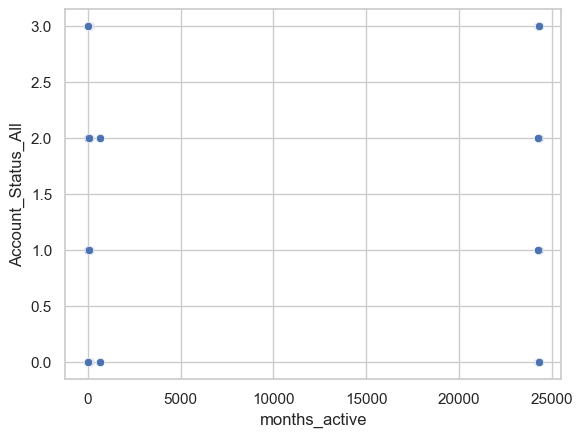

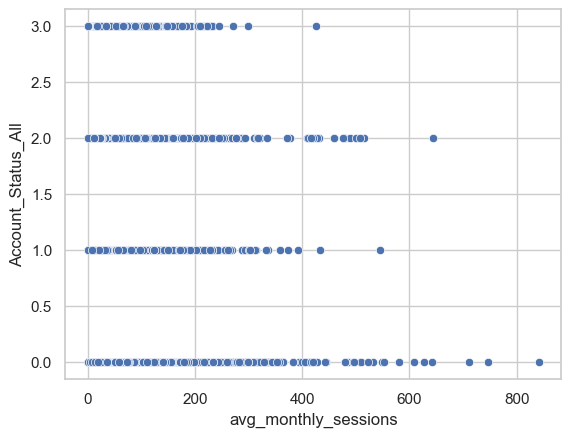

In [61]:
# Scatter plot of the numeric columns to understand distribution

for i in ['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU',
       'MAU', 'Chatting_WAU', 'months_active','avg_monthly_sessions']:
    sns.scatterplot(x=i, y='Account_Status_All', data=users_account)
    plt.show()

## Machine Learning

In [62]:
#Forwards Feature Selection
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression 
from sklearn import model_selection
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from mlxtend.classifier import StackingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
from sklearn.metrics import f1_score

import warnings
warnings.filterwarnings('ignore')

In [63]:
# Scale the data
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
users_account[['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU','MAU', 'Chatting_WAU', 'months_active','avg_monthly_sessions']] \
    = scaler.fit_transform(users_account[['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU','MAU', 'Chatting_WAU', 'months_active','avg_monthly_sessions']])
users_account.head()

,distinct_id,admin_role,country,subdomain,CSM,Phase,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation_Rate,WAU,MAU,Chatting_WAU,Industry,Chats,Comments,Documents,Form_Submitted,Posts,Forms_Created,months_active,avg_monthly_sessions,Account_Status_All,admin_level_all,admin_level_Member,admin_level_admin,admin_level_group_admin,admin_level_org_unit_admin,admin_level_stream_admin,Account_Status_Churned,Account_Status_Defend,Account_Status_Grow,Account_Status_Maintain
4,65c848ee-1504-496f-9dc6-ce28e04d449e,stream_admin,Germany,leffers,CS Operations,2 - Success: Engage,0.397766,-0.820081,0.982732,1.407551,1.146703,0.627734,Retail,1,1,0,0,0,0,-2.981244,4.891361,0,1,0,0,0,0,1,0,0,0,1
5,1f09d0a6-948c-440d-8187-2804e65807e8,Member,United States,hilton,Payal Kumar,2 - Success: Engage,0.380630,-0.812916,-0.633677,-1.238966,-1.663784,-0.812645,Hospitality,0,0,0,0,1,0,-2.981381,3.116410,2,0,1,0,0,0,0,0,1,0,0
9,4e719025-a4b3-42a7-ae58-0e67d85566da,Member,Switzerland,swisscasinos,Flurin Nigg,3 - Success: Operate,0.380630,-0.827927,1.000894,1.393348,1.236718,0.915810,Hospitality,1,0,0,1,0,0,-2.980970,1.927866,0,0,1,0,0,0,0,0,0,0,1
17,386ae683-d2c0-4e34-9324-4fb21b38ef09,Member,Switzerland,swisscasinos,Flurin Nigg,3 - Success: Operate,0.380630,-0.827927,1.000894,1.393348,1.236718,0.915810,Hospitality,1,0,1,1,0,0,-2.982066,1.130636,0,0,1,0,0,0,0,0,0,0,1
21,5d07e57c-2a16-45c3-a3f3-bb898366737c,Member,Germany,leffers,CS Operations,2 - Success: Engage,0.397766,-0.820081,0.982732,1.407551,1.146703,0.627734,Retail,1,1,0,0,0,0,-2.981244,2.955986,0,0,1,0,0,0,0,0,0,0,1


In [64]:
#Duplicate DataFrame
users_account_orig = users_account.copy()

#Split The Data
features = users_account[['WAU_Trend WAU_28_days', 'WAU_7_day_avg', 'Activation_Rate', 'WAU','MAU', 'Chatting_WAU', 'months_active','avg_monthly_sessions']]
X = features
y = users_account['Account_Status_All']

In [65]:
## Create training and testing subsets

X_train, X_test, y_train, y_test = train_test_split(X, y)

In [66]:
show_steps = True   # for testing/debugging

# conduct forward feature selection to determine the best features
included = []
# keep track of model and parameters
best = {'feature': '', 'r2': 0, 'a_r2': 0}
# create a model object to hold the modelling parameters
model = LinearRegression()
# get the number of cases in the training data
n = X_train.shape[0]

while True:
    changed = False

    if show_steps:
        print('')

    # list the features to be evaluated
    excluded = list(set(X.columns) - set(included))

    if show_steps:
        print('(Step) Excluded = %s' % ', '.join(excluded))

    # for each remaining feature to be evaluated
    for new_column in excluded:

        if show_steps:
            print('(Step) Trying %s...' % new_column)
            print('(Step) - Features = %s' % ', '.join(included + [new_column]))

        # fit the model with the Training data
        fit = model.fit(X_train[included + [new_column]], y_train)
        # calculate the score (R^2 for Regression)
        r2 = fit.score(X_train[included + [new_column]], y_train)
        # number of predictors in this model
        k = len(included + [new_column])
        # calculate the adjusted R^2
        adjusted_r2 = 1 - ( ( (1 - r2) * (n - 1) ) / (n - k - 1) )

        if show_steps:
            print('(Step) - Adjusted R^2: This = %.3f; Best = %.3f' %
                  (adjusted_r2, best['a_r2']))

        # if model improves
        if adjusted_r2 > best['a_r2']:
            # record new parameters
            best = {'feature': new_column, 'r2': r2, 'a_r2': adjusted_r2}
            # flag that found a better model
            changed = True
            if show_steps:
                print('(Step) - New Best!   : Feature = %s; R^2 = %.3f; Adjusted R^2 = %.3f' %
                      (best['feature'], best['r2'], best['a_r2']))
    # END for

    # if found a better model after testing all remaining features
    if changed:
        # update control details
        included.append(best['feature'])
        excluded = list(set(excluded) - set(best['feature']))
        print('Added feature %-4s with R^2 = %.3f and adjusted R^2 = %.3f' %
              (best['feature'], best['r2'], best['a_r2']))
    else:
        # terminate if no better model
        print('*'*50)
        break

print('')
print('Resulting features:')
print(', '.join(included))


(Step) Excluded = months_active, Activation_Rate, WAU, WAU_Trend WAU_28_days, WAU_7_day_avg, MAU, avg_monthly_sessions, Chatting_WAU
(Step) Trying months_active...
(Step) - Features = months_active
(Step) - Adjusted R^2: This = 0.001; Best = 0.000
(Step) - New Best!   : Feature = months_active; R^2 = 0.001; Adjusted R^2 = 0.001
(Step) Trying Activation_Rate...
(Step) - Features = Activation_Rate
(Step) - Adjusted R^2: This = 0.512; Best = 0.001
(Step) - New Best!   : Feature = Activation_Rate; R^2 = 0.512; Adjusted R^2 = 0.512
(Step) Trying WAU...
(Step) - Features = WAU
(Step) - Adjusted R^2: This = 0.725; Best = 0.512
(Step) - New Best!   : Feature = WAU; R^2 = 0.725; Adjusted R^2 = 0.725
(Step) Trying WAU_Trend WAU_28_days...
(Step) - Features = WAU_Trend WAU_28_days
(Step) - Adjusted R^2: This = 0.010; Best = 0.725
(Step) Trying WAU_7_day_avg...
(Step) - Features = WAU_7_day_avg
(Step) - Adjusted R^2: This = 0.001; Best = 0.725
(Step) Trying MAU...
(Step) - Features = MAU
(Step) -

### Decision Tree Classifier

In [67]:
model = DecisionTreeClassifier()

# Fit The Model

model.fit(X_train, y_train)

DecisionTreeClassifier()

In [68]:
# Make predictions
y_pred = model.predict(X_test)

In [69]:
# Calculate precision, recall, and F1-score
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

Precision: 1.0
Recall: 1.0
F1 Score: 1.0


In [70]:
def show_summary_report(actual, prediction):
    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(float)
    prediction_int = np.round(prediction)
    print('Accuracy : %.4f [TP / N]         Best: 1, Worst: 0' %
          accuracy_score(actual, prediction_int))
    msg = '           Proportion of predicted labels that match the true labels.'
    print(msg)
    print('Precision: %.4f [TP / (TP + FP)] Best: 1, Worst: 0' %
          precision_score(actual, prediction_int, average='weighted'))
    msg = '           Not to label a negative sample as positive.'
    print(msg)
    print('Recall   : %.4f [TP / (TP + FN)] Best: 1, Worst: 0' %
          recall_score(actual, prediction_int, average='weighted'))
    msg = '           Find all the positive samples.'
  
  
    plt.show()

In [71]:
y_train_pred = model.predict_proba(X_train)[:,1]

In [72]:
show_summary_report(y_train, y_train_pred)

Accuracy : 0.5070 [TP / N]         Best: 1, Worst: 0
           Proportion of predicted labels that match the true labels.
Precision: 0.3233 [TP / (TP + FP)] Best: 1, Worst: 0
           Not to label a negative sample as positive.
Recall   : 0.5070 [TP / (TP + FN)] Best: 1, Worst: 0


In [73]:
from sklearn.tree import export_graphviz
from graphviz import Source
from sklearn import tree

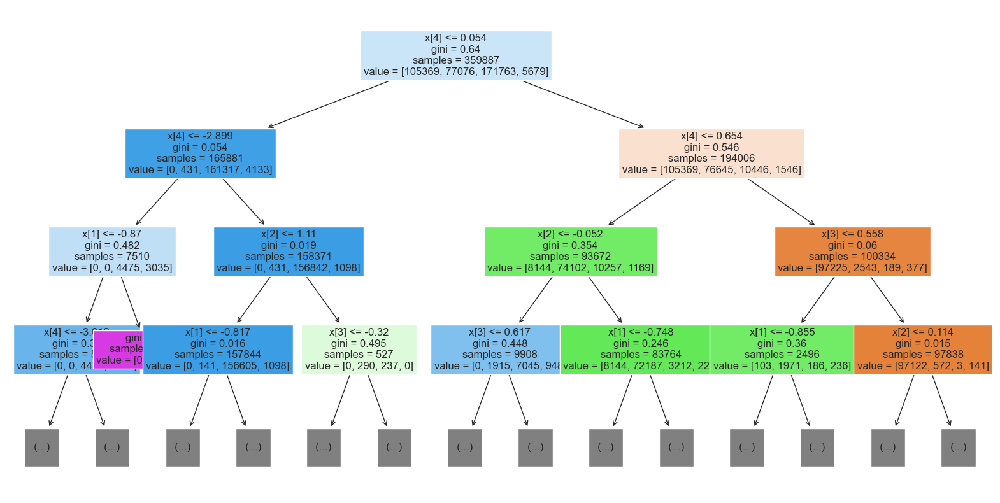

In [74]:
plt.figure(figsize=(20,10))
tree.plot_tree(model, max_depth=3, fontsize=12, filled=True)
plt.show()

# Neural Network

In [75]:
#Model Neural Network
from sklearn.neural_network import MLPClassifier

# Create a model
model3 = MLPClassifier(hidden_layer_sizes=(100, 100), max_iter=1000)

# Fit the model
model3.fit(X_train, y_train)


MLPClassifier(hidden_layer_sizes=(100, 100), max_iter=1000)

In [76]:
# Make predictions
y_pred3 = model3.predict(X_test)

# Calculate precision, recall, and F1-score
precision3 = precision_score(y_test, y_pred3, average='weighted')
recall3 = recall_score(y_test, y_pred3, average='weighted')
f13 = f1_score(y_test, y_pred3, average='weighted')

print(f"Precision: {precision3}")
print(f"Recall: {recall3}")
print(f"F1 Score: {f13}")


Precision: 0.999732869623683
Recall: 0.9997332510857514
F1 Score: 0.9997325769629074


### KMeans + PCA + KNN 

In [77]:
import hvplot.pandas
from pathlib import Path
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

k = 4
# 2 Clusters
k_mean2 = KMeans(n_clusters=k)
k_mean2.fit(X)

KMeans(n_clusters=4)

In [78]:
labels_2 = k_mean2.labels_
print(labels_2)

[3 3 3 ... 3 3 3]


In [79]:
k_mean2.inertia_

1778848.6665344317

In [80]:
k = 3
# 3 Clusters
k_mean3 = KMeans(n_clusters=k)
k_mean3.fit(X)

KMeans(n_clusters=3)

In [81]:
k_mean3.inertia_

2273372.122821454

In [82]:
# Predict the model segments (clusters)

account_clusters = k_mean3.predict(X)

#View the cluster centers
print(account_clusters)



[0 2 0 ... 1 1 0]


In [83]:
# Create a new column in the DataFrame with the predicted clusters
X['cluster'] = account_clusters

# Check the DataFrame
X.head()

,WAU_Trend WAU_28_days,WAU_7_day_avg,Activation_Rate,WAU,MAU,Chatting_WAU,months_active,avg_monthly_sessions,cluster
4,0.397766,-0.820081,0.982732,1.407551,1.146703,0.627734,-2.981244,4.891361,0
5,0.380630,-0.812916,-0.633677,-1.238966,-1.663784,-0.812645,-2.981381,3.116410,2
9,0.380630,-0.827927,1.000894,1.393348,1.236718,0.915810,-2.980970,1.927866,0
17,0.380630,-0.827927,1.000894,1.393348,1.236718,0.915810,-2.982066,1.130636,0
21,0.397766,-0.820081,0.982732,1.407551,1.146703,0.627734,-2.981244,2.955986,0


In [84]:
# Visualize the clusters

X.hvplot.scatter(
    x='WAU', 
    y='MAU', 
    by='cluster', 
    colormap='viridis',
    title = "Scatter Plot of WAU vs MAU by Cluster"
)

:NdOverlay   [cluster]
   :Scatter   [WAU]   (MAU)

## PCA

#### Rerun K-Means with PCA

In [85]:
#Reduce the number of features to 2 using PCA

pca = PCA(n_components=2)

#Fit the PCA model to X dataset

account_pca_data = pca.fit_transform(X)

#Review the PCA data
account_pca_data[:5]

array([[ 3.07903018,  3.88407577],
       [-1.7192422 ,  4.23352535],
       [ 2.92194645,  2.44917135],
       [ 2.8403793 ,  2.06694055],
       [ 2.88078704,  2.9548146 ]])

In [86]:
# Calculate the explained variance
pca.explained_variance_ratio_

array([0.40779647, 0.1789733 ])

In [87]:
#New Data Frame with PCA data

account_pca_df = pd.DataFrame(data=account_pca_data, columns=['PCA1', 'PCA2'])

#Add the cluster column to the PCA DataFrame
account_pca_df['cluster'] = account_clusters

#Check the PCA DataFrame
account_pca_df.head()

,PCA1,PCA2,cluster
0,3.079030,3.884076,0
1,-1.719242,4.233525,2
2,2.921946,2.449171,0
3,2.840379,2.066941,0
4,2.880787,2.954815,0


In [88]:
#Rerun Model on PCA data
# Intialize the KMeans model with 3 clusters
k_mean_pca = KMeans(n_clusters=3)

#Fit the model to the PCA data
k_mean_pca.fit(account_pca_data)

#Predict the clusters

account_pca_clusters = k_mean_pca.predict(account_pca_data)

print(account_pca_clusters)



[1 0 1 ... 0 0 1]


In [89]:
#Create a copy of the account_pca_df to store predictions   
account_pca_df_predictions = account_pca_df.copy()

# Create a new column in the DataFrame with the predicted clusters
account_pca_df_predictions['PCA_Clusters'] = account_pca_clusters

# Check the DataFrame
account_pca_df_predictions.sample(10)


,PCA1,PCA2,cluster,PCA_Clusters
181958,0.472737,0.278450,0,1
398725,1.337762,-0.732538,0,1
128896,1.734442,-0.100797,0,1
295118,1.109986,-0.297733,0,1
408432,-2.066276,0.656948,2,0
89173,-1.927881,0.974109,2,0
347312,-1.663713,0.692447,2,0
428365,0.561756,0.014069,0,1
142802,-2.764724,-1.257644,1,2
336540,-2.764852,-1.258300,1,2


In [90]:
# Create the scatter plot with x="PC1" and y="PC2"
account_pca_df_predictions.hvplot.scatter(
    x="PCA1",
    y="PCA2",
    by="PCA_Clusters",
    title = "Scatter Plot by Segment - PCA=2"
)

:NdOverlay   [PCA_Clusters]
   :Scatter   [PCA1]   (PCA2)

In [91]:
#Use Elbow method to determine te optimal number of clusters

k = list(range(1, 11))

#Create an empty list to store the inertia values

inertia = []

In [92]:
# Create a for loop to compute the inertia with each possible value of k
# Inside the loop:
# 1. Create a KMeans model using the loop counter for the n_clusters
# 2. Fit the model to the data using `df_stocks_pca`
# 3. Append the model.inertia_ to the inertia list
for i in k:
    model = KMeans(n_clusters=i, random_state=0)
    model.fit(account_pca_df)
    inertia.append(model.inertia_)

In [93]:
# Create a dictionary with the data to plot the Elbow curve
elbow_data_pca = {
    "k": k,
    "inertia": inertia
}

# Create a DataFrame with the data to plot the Elbow curve
df_elbow_pca = pd.DataFrame(elbow_data_pca)

In [94]:
# Plot a line chart with all the inertia values computed with 
# the different values of k to visually identify the optimal value for k.
elbow_plot_pca = df_elbow_pca.hvplot.line(x="k", y="inertia", title="Elbow Curve Using PCA Data", xticks=k)
elbow_plot_pca

:Curve   [k]   (inertia)

k=3 is the correct cluster count

### KNN

In [95]:
from itertools import combinations
from scipy import stats
from sklearn.neighbors import KNeighborsClassifier
plt.style.use('fivethirtyeight')

In [96]:
# make an instance of a KNeighborsClassifier object with 1 neighbor
knn = KNeighborsClassifier(n_neighbors=1)

# fit on the unstandardized data:
knn.fit(X, y)

KNeighborsClassifier(n_neighbors=1)

In [97]:
# predict the response values for the observations in X ("test the model")
# store the predicted response values
y_pred_class = knn.predict(X)

# compute classification accuracy
from sklearn import metrics

print(metrics.accuracy_score(y, y_pred_class))

1.0


In [98]:
# STEP 1: split X and y into training and testing sets (using random_state for reproducibility)
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, test_size=0.2)

# STEP 2: train the model on the training set (using K=1)
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train, y_train)

# STEP 3: test the model on the testing set, and check the accuracy
y_pred_class = knn.predict(X_test)
print(metrics.accuracy_score(y_test, y_pred_class))

0.9998228613108263


In [99]:
# Find rows in X_train
kx = 5000

# Fit new KNN model
knn = KNeighborsClassifier(n_neighbors=kx)
knn.fit(X_train, y_train)
y_pred_class = knn.predict(X_test)

# What is the accuracy when k = number of rows?
print(metrics.accuracy_score(y_test, y_pred_class))

0.9455454829634261


In [100]:
# Get accuracy of models with increasing number of neighbors
test_acc = []

for i in range(1, 20):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    test_acc.append(knn.score(X_test, y_test))

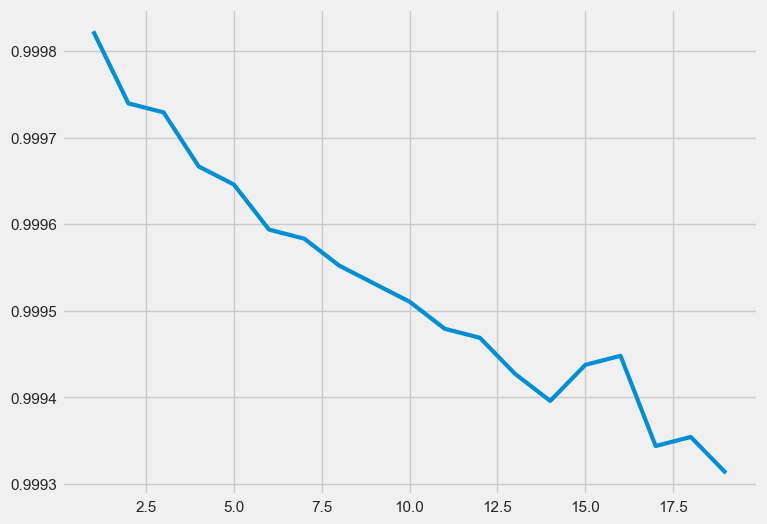

In [101]:
# plot test accuracy by number of neighbors:

fig, ax = plt.subplots(figsize=(8,6))
ax.plot(list(range(1, 20)), test_acc, lw=3.)
plt.show()